In [1]:
import pandas as pd 
import numpy as np 
import seaborn as sns
import matplotlib.pyplot as plt 
import warnings

warnings.filterwarnings('ignore')


In [2]:
# Loading the dataset
df = pd.read_csv(r"C:\Users\hp\OneDrive\Desktop\WaterBodies.csv")
df.head()

,rural_or_urban,State Name,District Name,Block/Tehsil Name,Village Name,town_municipalty_name,ward_name,si_no_of_water_body_within_village_town,unique_id,water_body_name,...,no_people_benefited_by_water_body,ref_selection_id_wua_exists_name,extent_of_area_covered_by_wua,number_of_wua_formed,ref_selection_id_dip_sip_exists_name,ref_selection_id_water_body_encroached_name,ref_selection_id_encroachment_assessed_name,area_encroached_percentage,reason_water_body_in_use_name2,reason_water_body_in_use_name3
0,Rural,RAJASTHAN,BHILWARA,PHULIAKALAN,SARDARPURA,NaN,NaN,2,1/22/007/000014/000028/002,NaN,...,10.0,No,NaN,NaN,No,No,NaN,NaN,NaN,NaN
1,Rural,RAJASTHAN,AJMER,BHINAI,KARANTI,NaN,NaN,3,1/22/001/000003/000037/003,NaN,...,NaN,No,NaN,NaN,No,No,NaN,NaN,NaN,NaN
2,Rural,RAJASTHAN,AJMER,BHINAI,BANDANWADA,NaN,NaN,2,1/22/001/000003/000013/002,NaN,...,NaN,No,NaN,NaN,No,No,NaN,NaN,NaN,NaN
3,Rural,RAJASTHAN,AJMER,BEAWER,DHOLADATA 1,NaN,NaN,1,1/22/001/000002/000044/001,NaN,...,NaN,No,NaN,NaN,No,No,NaN,NaN,NaN,NaN
4,Rural,RAJASTHAN,JALORE,JALORE,SANTHU,NaN,NaN,2,1/22/019/000004/000072/002,MAMANADEE SANTHU,...,NaN,No,NaN,NaN,No,No,NaN,NaN,NaN,NaN


In [3]:
df.shape

(16939, 55)

In [4]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 16939 entries, 0 to 16938
Data columns (total 55 columns):
 #   Column                                                      Non-Null Count  Dtype  
---  ------                                                      --------------  -----  
 0   rural_or_urban                                              16939 non-null  object 
 1   State Name                                                  16939 non-null  object 
 2   District Name                                               16939 non-null  object 
 3   Block/Tehsil Name                                           16750 non-null  object 
 4   Village Name                                                16750 non-null  object 
 5   town_municipalty_name                                       189 non-null    object 
 6   ward_name                                                   189 non-null    object 
 7   si_no_of_water_body_within_village_town                     16939 non-null  int64  
 

In [5]:
for i in df.columns:
    print(df[i].value_counts())
    print("\n")

rural_or_urban
Rural    16750
Urban      189
Name: count, dtype: int64


State Name
RAJASTHAN    16939
Name: count, dtype: int64


District Name
AJMER             3519
TONK              1934
BHILWARA          1877
KARAULI           1470
BHARATPUR         1315
JALORE            1065
SAWAI MADHOPUR     940
UDAIPUR            775
RAJSAMAND          555
JAISALMER          489
JODHPUR            468
CHITTORGARH        453
PALI               423
BARMER             339
NAGAUR             234
BANSWARA           221
KOTA               217
JHALAWAR           140
BARAN              118
DUNGARPUR           83
JAIPUR              82
PRATPGARH           75
SIROHI              71
SIKAR               53
DHAOLPUR            12
DAUSA                9
ALWAR                2
Name: count, dtype: int64


Block/Tehsil Name
KEKRI         1624
MALPURA       1528
NADOTI        1367
SARWAD         656
AHORE          437
              ... 
SARMATHURA       1
CHITALWANA       1
HAMIRGARH        1
GALIAKOT         

In [6]:
print(df.isnull().sum())

rural_or_urban                                                    0
State Name                                                        0
District Name                                                     0
Block/Tehsil Name                                               189
Village Name                                                    189
town_municipalty_name                                         16750
ward_name                                                     16750
si_no_of_water_body_within_village_town                           0
unique_id                                                         0
water_body_name                                                7413
basin_name                                                    16321
sub_basin_name                                                16609
ref_water_body_type_id_name                                       0
nature_of_storage                                             15364
khasra_number                                   

In [7]:
# Dropping columns with constant values
df = df.drop(columns=df.columns[df.nunique() == 1], axis=1)

In [8]:
df.shape

(16939, 54)

In [9]:
# Imputing missing values for numerical columns
df['storage_capacity_water_body_present'].fillna(df['storage_capacity_water_body_present'].mean(), inplace=True)
df['irrigation_potential_revived'].fillna(df['irrigation_potential_revived'].median(), inplace=True)


In [10]:
# Imputing missing values for categorical columns
df['water_body_name'].fillna('Unknown', inplace=True)
df['ref_reason_water_body_in_use_id1_name'].fillna(df['ref_reason_water_body_in_use_id1_name'].mode()[0], inplace=True)
df['basin_name'].fillna('Unknown', inplace=True)
df['nature_of_storage'].fillna('Unknown', inplace=True)
df['town_municipalty_name'].fillna('Unknown', inplace=True)
df['sub_basin_name'].fillna(df['sub_basin_name'].mode()[0], inplace=True)


In [11]:
# Dropping rows where critical data is missing
df.dropna(subset=['latitude_dec', 'longitude_dec'], inplace=True)

In [12]:
# Filling remaining numeric columns with median or mean
df['cca_water_body'].fillna(df['cca_water_body'].median(), inplace=True)
df['ipc_water_body'].fillna(df['ipc_water_body'].median(), inplace=True)
df['construction_cost'].fillna(df['construction_cost'].mean(), inplace=True)
df['renovation_cost'].fillna(df['renovation_cost'].mean(), inplace=True)
df['storage_capacity_water_body_present'].fillna(df['storage_capacity_water_body_present'].median(), inplace=True)


In [13]:
# If renovation_year is missing, and renovation_cost is missing too, dropping the row
df.dropna(subset=['renovation_year', 'renovation_cost'], how='all', inplace=True)

In [14]:
#Set threshold and dropping columns with too many missing values
threshold = 0.7 * len(df)
df.dropna(axis=1, thresh=threshold, inplace=True)

# Dropping rows where the 'storage_capacity_water_body_present' column is missing (target column)
df.dropna(subset=['storage_capacity_water_body_present'], inplace=True)

# Recalculating missing percentages after dropping rows and columns
missing_percentage = df.isnull().sum() / len(df) * 100
print(missing_percentage)

# Dropping columns where more than 70% of the data is missing based on the updated percentage
columns_to_drop = missing_percentage[missing_percentage > 70].index
df.drop(columns=columns_to_drop, inplace=True)


rural_or_urban                                                 0.000000
District Name                                                  0.000000
Block/Tehsil Name                                              1.192342
Village Name                                                   1.192342
town_municipalty_name                                          0.000000
si_no_of_water_body_within_village_town                        0.000000
unique_id                                                      0.000000
water_body_name                                                0.000000
basin_name                                                     0.000000
sub_basin_name                                                 0.000000
ref_water_body_type_id_name                                    0.000000
nature_of_storage                                              0.000000
khasra_number                                                  1.798733
latitude_dec                                                   0

In [15]:
# Again checking for null values
print(df.isnull().sum())

rural_or_urban                                                   0
District Name                                                    0
Block/Tehsil Name                                              175
Village Name                                                   175
town_municipalty_name                                            0
si_no_of_water_body_within_village_town                          0
unique_id                                                        0
water_body_name                                                  0
basin_name                                                       0
sub_basin_name                                                   0
ref_water_body_type_id_name                                      0
nature_of_storage                                                0
khasra_number                                                  264
latitude_dec                                                     0
longitude_dec                                                 

In [16]:
df.shape

(14677, 37)

In [17]:
df['Block/Tehsil Name'].fillna('Unknown', inplace=True)
df['Village Name'].fillna('Unknown', inplace=True)
df['khasra_number'].fillna('Not Available', inplace=True)

In [18]:
df['storage_capacity_water_body_original'].fillna(df['storage_capacity_water_body_original'].median(), inplace=True)
df['filled_up_storage_name'].fillna('Unknown', inplace=True)
df['filled_up_storage_space_name'].fillna('Unknown', inplace=True)
df['no_villages_benefited'].fillna(df['no_villages_benefited'].median(), inplace=True)
df['no_people_benefited_by_water_body'].fillna(df['no_people_benefited_by_water_body'].median(), inplace=True)
df['ref_selection_id_wua_exists_name'].fillna('Unknown', inplace=True)


In [19]:
# Recalculating missing values
missing_percentage = df.isnull().sum() / len(df) * 100
print(missing_percentage)

# Dropping rows with any remaining missing values
df.dropna(inplace=True)


rural_or_urban                                                0.0
District Name                                                 0.0
Block/Tehsil Name                                             0.0
Village Name                                                  0.0
town_municipalty_name                                         0.0
si_no_of_water_body_within_village_town                       0.0
unique_id                                                     0.0
water_body_name                                               0.0
basin_name                                                    0.0
sub_basin_name                                                0.0
ref_water_body_type_id_name                                   0.0
nature_of_storage                                             0.0
khasra_number                                                 0.0
latitude_dec                                                  0.0
longitude_dec                                                 0.0
water_body

In [20]:
print(df.info())
print(df.describe())

<class 'pandas.core.frame.DataFrame'>
Index: 14677 entries, 0 to 16938
Data columns (total 37 columns):
 #   Column                                                      Non-Null Count  Dtype  
---  ------                                                      --------------  -----  
 0   rural_or_urban                                              14677 non-null  object 
 1   District Name                                               14677 non-null  object 
 2   Block/Tehsil Name                                           14677 non-null  object 
 3   Village Name                                                14677 non-null  object 
 4   town_municipalty_name                                       14677 non-null  object 
 5   si_no_of_water_body_within_village_town                     14677 non-null  int64  
 6   unique_id                                                   14677 non-null  object 
 7   water_body_name                                             14677 non-null  object 
 8   b

In [21]:
df.shape

(14677, 37)

In [22]:
df.isnull().sum().sum()

0

In [23]:
#checking for duplicate values
df.duplicated().sum().sum()

0

We Have handled all missing and null values.

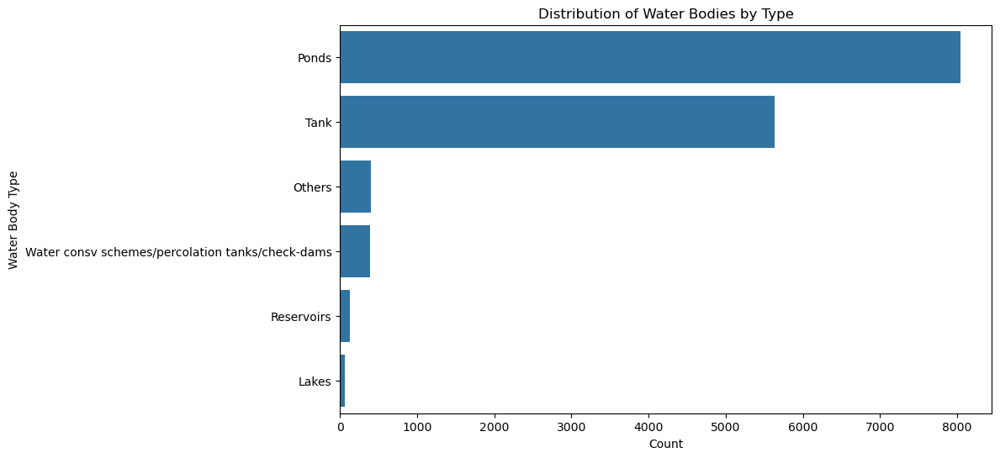

In [29]:
#type_distribution = df['ref_water_body_type_id_name'].value_counts()
#print(type_distribution)

# Distribution of Water Bodies by Type
plt.figure(figsize=(10, 6))
sns.countplot(y='ref_water_body_type_id_name', data=df, order=df['ref_water_body_type_id_name'].value_counts().index)
plt.title('Distribution of Water Bodies by Type')
plt.xlabel('Count')
plt.ylabel('Water Body Type')
plt.show()


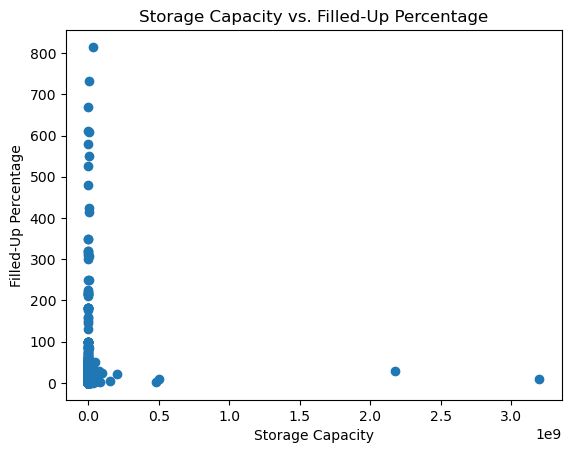

In [25]:
# Scatter plot of storage capacity vs. filled-up percentage
plt.scatter(df['storage_capacity_water_body_present'], df['max_depth_water_body_fully_filled'])
plt.title('Storage Capacity vs. Filled-Up Percentage')
plt.xlabel('Storage Capacity')
plt.ylabel('Filled-Up Percentage')
plt.show()


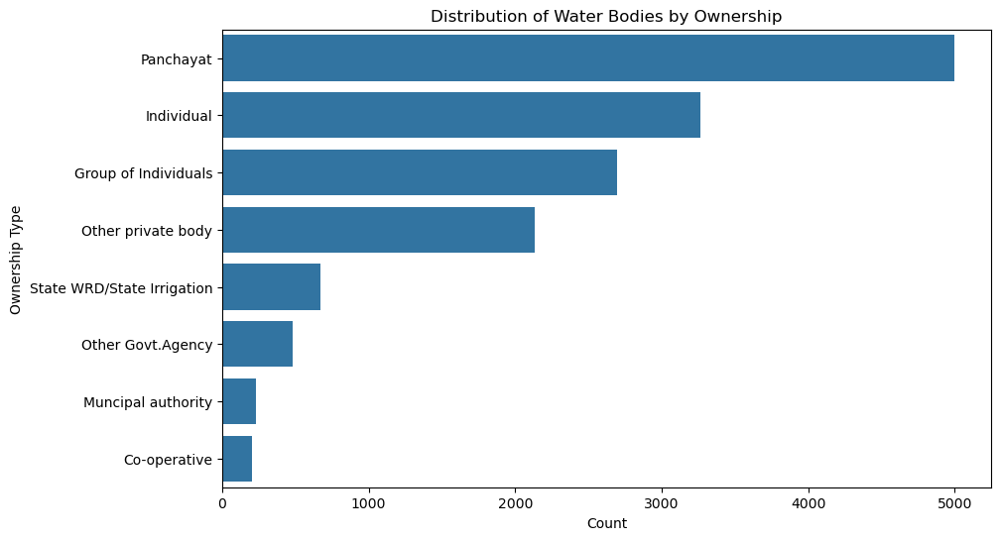

In [26]:
#ownership_distribution = df['water_body_ownership_name'].value_counts()
#print(ownership_distribution)

# Distribution of Water Bodies by Ownership
plt.figure(figsize=(10, 6))
sns.countplot(y='water_body_ownership_name', data=df, order=df['water_body_ownership_name'].value_counts().index)
plt.title('Distribution of Water Bodies by Ownership')
plt.xlabel('Count')
plt.ylabel('Ownership Type')
plt.show()

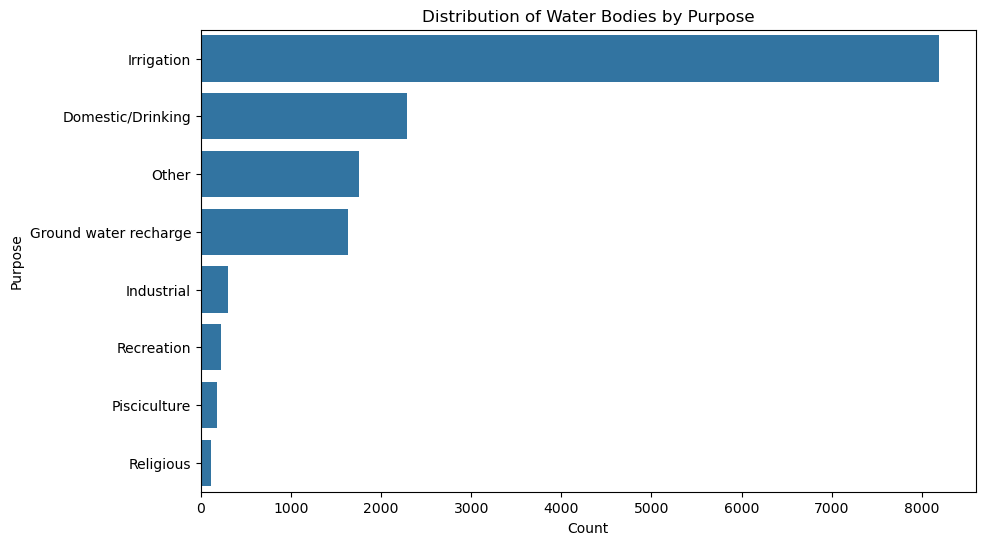

In [27]:
#purpose_distribution = df['ref_reason_water_body_in_use_id1_name'].value_counts()
#print(purpose_distribution)

# Distribution of Water Bodies by Purpose
plt.figure(figsize=(10, 6))
sns.countplot(y='ref_reason_water_body_in_use_id1_name', data=df, order=df['ref_reason_water_body_in_use_id1_name'].value_counts().index)
plt.title('Distribution of Water Bodies by Purpose')
plt.xlabel('Count')
plt.ylabel('Purpose')
plt.show()

In [30]:
import folium
# Creating a map centered around Rajasthan, India
map_center = [27.3913, 73.4326]  # Coordinates of Rajasthan
m = folium.Map(location=map_center, zoom_start=6)

# Adding water bodies to the map
for idx, row in df.iterrows():
    if pd.notna(row['latitude_dec']) and pd.notna(row['longitude_dec']):
        folium.CircleMarker(
            location=[row['latitude_dec'], row['longitude_dec']],
            radius=5,
            popup=f"Water Body: {row['water_body_name']}, Type: {row['ref_water_body_type_id_name']}",
            color='blue',
            fill=True,
            fill_color='blue'
        ).add_to(m)

# Displaying the map
m.save('rajasthan_water_bodies_map.html')
m


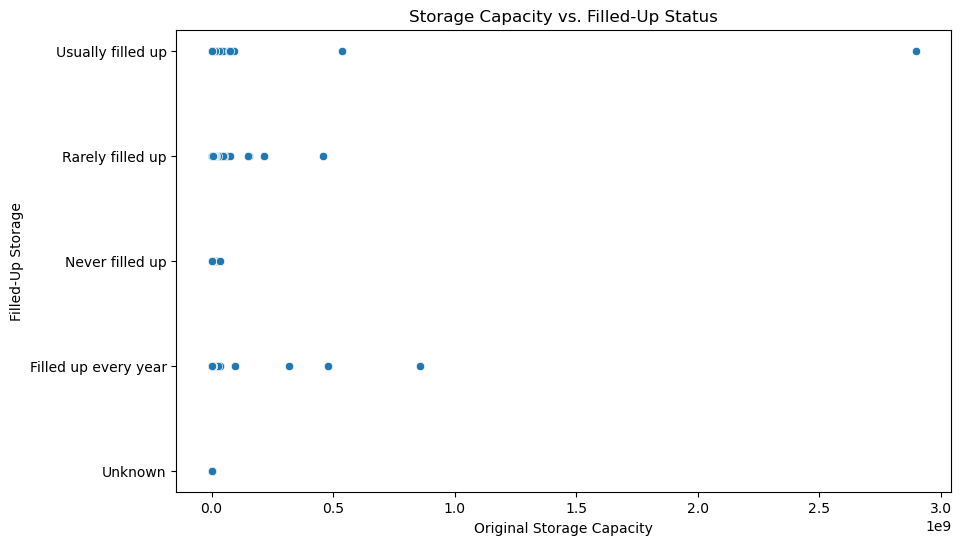

In [32]:
#Storage Capacity vs. Filled-Up Status

plt.figure(figsize=(10, 6))
sns.scatterplot(x='storage_capacity_water_body_original', y='filled_up_storage_space_name', data=df)
plt.title('Storage Capacity vs. Filled-Up Status')
plt.xlabel('Original Storage Capacity')
plt.ylabel('Filled-Up Storage')
plt.show()


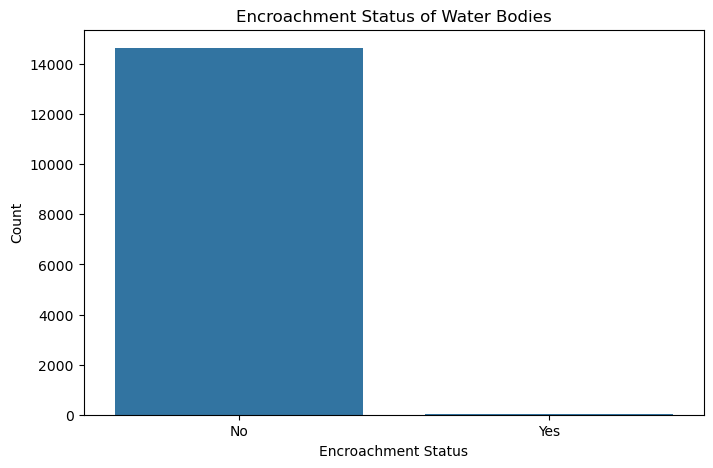

In [33]:
#encroachment_status = df['ref_selection_id_water_body_encroached_name'].value_counts()
#print(encroachment_status)

# Encroachment Status of Water Bodies
plt.figure(figsize=(8, 5))
sns.countplot(x='ref_selection_id_water_body_encroached_name', data=df)
plt.title('Encroachment Status of Water Bodies')
plt.xlabel('Encroachment Status')
plt.ylabel('Count')
plt.show()


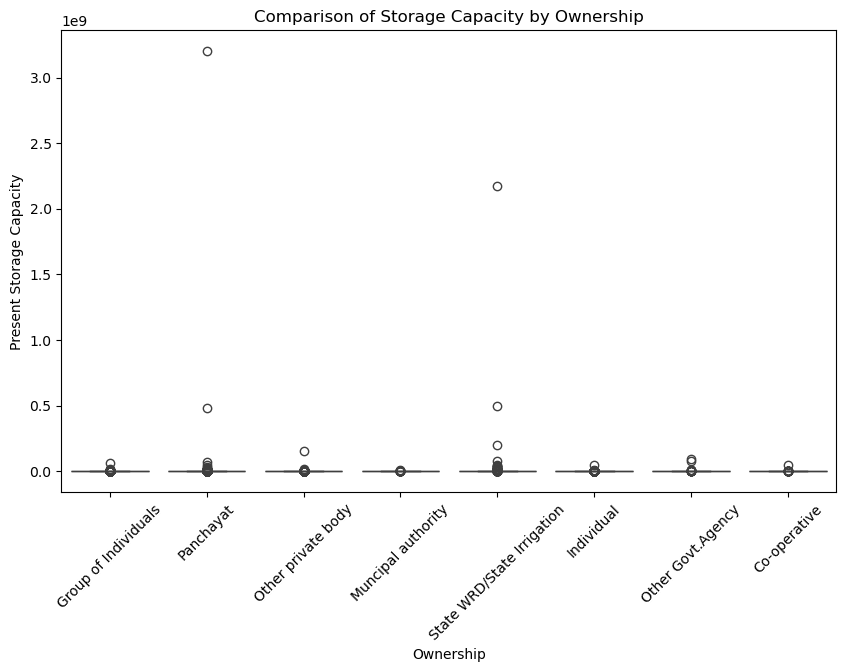

In [34]:
#Comparative analysis
plt.figure(figsize=(10, 6))
sns.boxplot(x='water_body_ownership_name', y='storage_capacity_water_body_present', data=df)
plt.title('Comparison of Storage Capacity by Ownership')
plt.xlabel('Ownership')
plt.ylabel('Present Storage Capacity')
plt.xticks(rotation=45)
plt.show()

In [36]:
# Check the data types of the columns
print(df.dtypes[['storage_capacity_water_body_present', 'filled_up_storage_space_name']])

storage_capacity_water_body_present    float64
filled_up_storage_space_name            object
dtype: object


In [37]:
# Convert columns to numeric, coerce errors to NaN
df['filled_up_storage_space_name'] = pd.to_numeric(df['filled_up_storage_space_name'], errors='coerce')


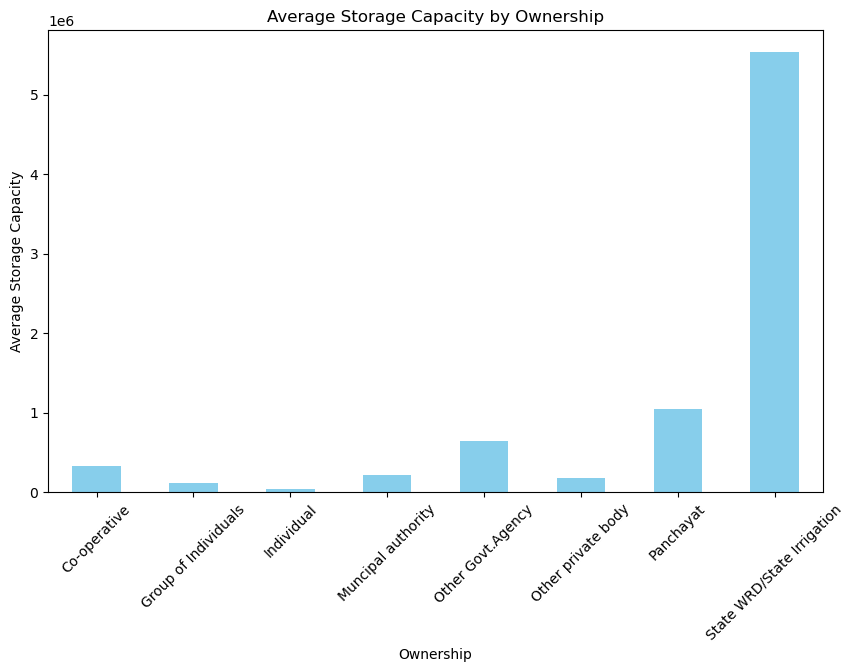

In [41]:
# Calculating the average storage capacity by ownership
avg_storage_capacity = df.groupby('water_body_ownership_name')['storage_capacity_water_body_present'].mean()

# Plot average storage capacity
plt.figure(figsize=(10, 6))
avg_storage_capacity.plot(kind='bar', color='skyblue')
plt.title('Average Storage Capacity by Ownership')
plt.ylabel('Average Storage Capacity')
plt.xlabel('Ownership')
plt.xticks(rotation=45)
plt.show()


Now We will perform a t-test to see if there are statistically significant differences in storage capacity between water bodies owned by panchayats and individuals.

In [42]:
from scipy.stats import ttest_ind

# Extracting data for Panchayats and Individuals
panchayat_storage = df[df['water_body_ownership_name'] == 'Panchayat']['storage_capacity_water_body_present']
individual_storage = df[df['water_body_ownership_name'] == 'Individual']['storage_capacity_water_body_present']

# Performing t-test
t_stat, p_value = ttest_ind(panchayat_storage.dropna(), individual_storage.dropna())
print(f'T-Test for Storage Capacity by Ownership: t-statistic={t_stat}, p-value={p_value}')


T-Test for Storage Capacity by Ownership: t-statistic=1.2491050878496046, p-value=0.21166204952910164


Top 5 Districts with Highest and Lowest Water Body Density

In [44]:
# Making Group by district and calculating the number of water bodies
district_density = df.groupby('District Name').size().reset_index(name='count')

# Sorting and finding top 5 districts
top_5_districts = district_density.sort_values(by='count', ascending=False).head(5)
print(top_5_districts)

# Bottom 5 districts
bottom_5_districts = district_density.sort_values(by='count', ascending=True).head(5)
print(bottom_5_districts)


   District Name  count
0          AJMER   3103
25          TONK   1899
6       BHILWARA   1466
5      BHARATPUR   1262
16       KARAULI    924
   District Name  count
1          ALWAR      2
8          DAUSA      9
9       DHAOLPUR     12
23         SIKAR     37
24        SIROHI     53


    water_body_ownership_name  storage_capacity_water_body_present  \
0                Co-operative                         3.358764e+05   
1        Group of Individuals                         1.178967e+05   
2                  Individual                         4.332266e+04   
3          Muncipal authority                         2.177277e+05   
4           Other Govt.Agency                         6.487244e+05   
5          Other private body                         1.800681e+05   
6                   Panchayat                         1.045109e+06   
7  State WRD/State Irrigation                         5.534820e+06   

   filled_up_storage_space_name  
0                           NaN  
1                           NaN  
2                           NaN  
3                           NaN  
4                           NaN  
5                           NaN  
6                           NaN  
7                           NaN  


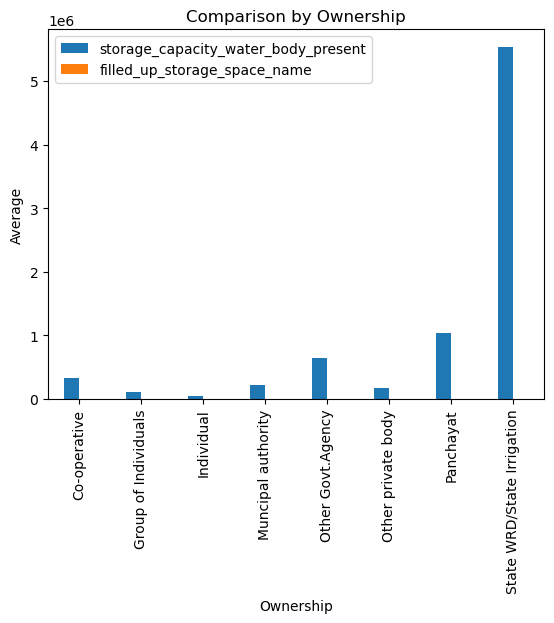

In [46]:
ownership_comparison = df.groupby('water_body_ownership_name').agg({
    'storage_capacity_water_body_present': 'mean',
    'filled_up_storage_space_name': 'mean'
}).reset_index()
print(ownership_comparison)

# Bar chart for comparison
ownership_comparison.plot(kind='bar', x='water_body_ownership_name', 
                          y=['storage_capacity_water_body_present', 'filled_up_storage_space_name'])
plt.title('Comparison by Ownership')
plt.xlabel('Ownership')
plt.ylabel('Average')
plt.show()


In [47]:
# T-test between panchayat-owned and individual-owned water bodies
panchayat_owned = df[df['water_body_ownership_name'] == 'Panchayat']['storage_capacity_water_body_present'].dropna()
individual_owned = df[df['water_body_ownership_name'] == 'Individual']['storage_capacity_water_body_present'].dropna()

t_stat, p_val = ttest_ind(panchayat_owned, individual_owned)
print(f"T-test results: t-statistic={t_stat}, p-value={p_val}")


T-test results: t-statistic=1.2491050878496046, p-value=0.21166204952910164


In [51]:
df.columns

Index(['rural_or_urban', 'District Name', 'Block/Tehsil Name', 'Village Name',
       'town_municipalty_name', 'si_no_of_water_body_within_village_town',
       'unique_id', 'water_body_name', 'basin_name', 'sub_basin_name',
       'ref_water_body_type_id_name', 'nature_of_storage', 'khasra_number',
       'latitude_dec', 'longitude_dec', 'water_body_loc_name',
       'water_body_ownership_name', 'ref_water_body_in_use_id_name',
       'ref_reason_water_body_in_use_id1_name', 'cca_water_body',
       'ipc_water_body', 'water_body_nature_name', 'construction_cost',
       'renovation_cost',
       'ref_water_body_under_repair_renovation_restoration_id_name',
       'irrigation_potential_revived', 'water_spread_area_of_water_body',
       'max_depth_water_body_fully_filled',
       'storage_capacity_water_body_original',
       'storage_capacity_water_body_present', 'filled_up_storage_name',
       'filled_up_storage_space_name', 'no_villages_benefited',
       'no_people_benefited_by_wa

In [58]:
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error, r2_score

# Selecting  features
features = ['max_depth_water_body_fully_filled', 'water_spread_area_of_water_body', 
            'irrigation_potential_revived', 'no_people_benefited_by_water_body']

# Defining independent variables (x1) and dependent variable (y1)
x1 = df[features]
y1 = df['storage_capacity_water_body_present']

# Ensuring that there are no missing values in the features and target variable
x1 = x1.dropna()
y1 = y1[x1.index]  # Aligning y1 with the cleaned x1



In [59]:
# standardizing the features
from sklearn.preprocessing import StandardScaler

scaler = StandardScaler()
x1= pd.DataFrame(scaler.fit_transform(x1), columns = x1.columns)
x1

,max_depth_water_body_fully_filled,water_spread_area_of_water_body,irrigation_potential_revived,no_people_benefited_by_water_body
0,-0.081603,-0.029072,-0.010252,-0.021206
1,-0.081603,-0.029105,-0.010252,-0.019318
2,1.443675,-0.029105,-0.010252,-0.019318
3,-0.180008,-0.028987,-0.010252,-0.019318
4,-0.081603,-0.028756,-0.010252,-0.019318
...,...,...,...,...
14672,-0.278413,-0.029015,-0.010252,-0.021383
14673,-0.180008,-0.028447,-0.010252,-0.019318
14674,-0.130806,-0.028611,-0.010252,-0.021088
14675,-0.130806,-0.028447,-0.010252,-0.021088


In [60]:
# Checking for multicollinearity
from statsmodels.stats.outliers_influence import variance_inflation_factor

vif_data = pd.DataFrame()
vif_data["Variable"] = x1.columns
vif_data["VIF"] = [variance_inflation_factor(x1.values, i) for i in range(x1.shape[1])]

print(vif_data)

                            Variable       VIF
0  max_depth_water_body_fully_filled  1.008121
1    water_spread_area_of_water_body  1.008040
2       irrigation_potential_revived  1.000007
3  no_people_benefited_by_water_body  1.000075


There is no Multicollinearity exists. So we will move ahead.

In [64]:
# Splitting the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(x1, y1, test_size=0.2, random_state=62)

In [67]:
from sklearn.linear_model import LinearRegression 
from sklearn.ensemble import RandomForestRegressor 
from sklearn.tree import DecisionTreeRegressor 
from sklearn.neighbors import KNeighborsRegressor as KNN 
from sklearn.linear_model import Lasso, Ridge
from sklearn.model_selection import cross_val_score

In [69]:
models = [
    LinearRegression(),
    RandomForestRegressor(),
    DecisionTreeRegressor(),
    KNN(),
    Lasso(),
    Ridge()
]

for model in models:
    model_name = model.__class__.__name__
    
    # Fitting the model
    model.fit(x_train, y_train)
    
    # Predictions
    y_pred = model.predict(x_test)
    y_pred_train = model.predict(x_train)
    
    # Evaluation
    r2_test = r2_score(y_test, y_pred)
    r2_train = r2_score(y_train, y_pred_train) * 100
    mae = mean_absolute_error(y_test, y_pred)
    mse = mean_squared_error(y_test, y_pred)
    rmse = np.sqrt(mse)
    
    # Cross-validation
    score = cross_val_score(model, x1, y1, cv=5, scoring="r2")
    
    # Printing results
    print(f"Results for {model_name}:")
    print('R2_score: ', r2_test)
    print('R2_score on training Data:', r2_train)
    print('Mean Absolute Error:-', mae)
    print('Mean Squared Error:-', mse)
    print("Root Mean Squared Error:-", rmse)
    
     # Cross-validation scores
    print("Cross-validation scores:", score)
    print("Mean Cross-validation score:", score.mean())
    print("Difference between R2 score and cross-validation score is", (r2_test - score.mean()) * 100)
   
    
    print("\n" + "="*40 + "\n")

Results for LinearRegression:
R2_score:  -9.757350155403799e-05
R2_score on training Data: 0.000266802376414077
Mean Absolute Error:- 1458157.509022434
Mean Squared Error:- 1623714137410481.2
Root Mean Squared Error:- 40295336.42259959
Cross-validation scores: [-0.00155171  0.00056321 -0.10880311 -0.11062245 -0.00046562]
Mean Cross-validation score: -0.04417593558340651
Difference between R2 score and cross-validation score is 4.407836208185247


Results for RandomForestRegressor:
R2_score:  -0.8082134152017468
R2_score on training Data: 80.872968039681
Mean Absolute Error:- 2492284.388035043
Mean Squared Error:- 2935735235751776.5
Root Mean Squared Error:- 54182425.52481179
Cross-validation scores: [-1.88520622e+01 -1.11016437e+01 -3.12906290e+01 -1.86129643e+01
 -1.50046178e-03]
Mean Cross-validation score: -15.971759934404034
Difference between R2 score and cross-validation score is 1516.3546519202287


Results for DecisionTreeRegressor:
R2_score:  -2.294857434214139
R2_score on tra

In [70]:
from sklearn.model_selection import GridSearchCV

params = {
    'n_estimators': [50, 100, 200],
    'max_depth': [None, 10, 20, 30],
    'min_samples_split': [2, 5, 10],
    'min_samples_leaf': [1, 2, 4]
}

In [71]:
# Initializing GridSearchCV
grid_search = GridSearchCV(RandomForestRegressor(), params, cv=5, scoring='accuracy')


In [72]:
# Fittng the model
grid_search.fit(x_train, y_train)

GridSearchCV(cv=5, estimator=RandomForestRegressor(),
             param_grid={'max_depth': [None, 10, 20, 30],
                         'min_samples_leaf': [1, 2, 4],
                         'min_samples_split': [2, 5, 10],
                         'n_estimators': [50, 100, 200]},
             scoring='accuracy')

In [73]:
# Getting the best parameters
best_params = grid_search.best_params_
print(f'Best Parameters: {best_params}')

Best Parameters: {'max_depth': None, 'min_samples_leaf': 1, 'min_samples_split': 2, 'n_estimators': 50}


In [74]:
best_model = grid_search.best_estimator_

# Making predictions on the test set using the best model
pred = best_model.predict(x_test)

print("R2_score: ",r2_score (y_test, pred))
print('Mean Absolute Error:-', mean_absolute_error(y_test, pred)) 
print('Mean Squared Error:-',mean_squared_error(y_test, pred))
print("Root Mean Squared Error:-", np.sqrt(mean_squared_error(y_test, pred)))

R2_score:  -0.6239733421178852
Mean Absolute Error:- 2231397.5674520065
Mean Squared Error:- 2636611210986465.5
Root Mean Squared Error:- 51347942.616880625


In [75]:
import joblib
joblib.dump(best_model, "waterbodies.pkl")

['waterbodies.pkl']

In [76]:
# loading the saved model and get the predictions
model=joblib.load("waterbodies.pkl")

# Prediction
prediction = model.predict(x_test)
a = np.array(y_test)
df4 = pd.DataFrame()
df4["Predicted"] = prediction
df4["Original"] = a
df4

,Predicted,Original
0,248401.604941,2000.000000
1,561935.659154,2200.000000
2,169812.044423,40000.000000
3,45026.524095,50.000000
4,29637.973333,2000.000000
...,...,...
2931,248401.604941,696853.719585
2932,67015.533333,1800.000000
2933,71244.346892,582400.000000
2934,243908.641484,32000.000000
